In [1]:
import pandas as pd # For DataFrame and handling
import numpy as np # Array and numerical processing
from scipy import stats
import seaborn as sns # High level Plotting
import statsmodels.api as sm # Modeling, e.g. ANOVA
from statsmodels.formula.api import ols 


reading the dataset

In [3]:
jems = pd.read_csv("data/diamonds.csv")

Explore the data set 

In [ ]:
type(jems)
jems.columns # names
jems.describe()
jems.info()
jems.head()
jems.tail()
jems.sample(n = 10)

How many diamonds with a clarity of category “IF” are present in the data-set?

In [4]:
len(jems[jems.clarity == "IF"])


1790

print all counts 

In [6]:
jems.clarity.value_counts()


SI1     13065
VS2     12258
SI2      9194
VS1      8171
VVS2     5066
VVS1     3655
IF       1790
I1        741
Name: clarity, dtype: int64

What fraction of the total do they represent?

In [7]:
len(jems[jems.clarity == "IF"])/len(jems)

0.03318502039302929

What is the cheapest diamond price overall? 

In [8]:
#series
min(jems.price)
#DataFrame
jems['price'].min()

326

What is the range of diamond prices? 

In [9]:
def getRange (x):
    low = min(x)
    high = max(x)
    return low, high

In [10]:
price_range = getRange(jems.price)

low, high = getRange(jems.price)

price_range


(326, 18823)

What is the average diamond price in each category of cut and color?

In [11]:
jems.groupby(["cut", "color"])["price"].mean()



cut        color
Fair       D        4291.061350
           E        3682.312500
           F        3827.003205
           G        4239.254777
           H        5135.683168
           I        4685.445714
           J        4975.655462
Good       D        3405.382175
           E        3423.644159
           F        3495.750275
           G        4123.482204
           H        4276.254986
           I        5078.532567
           J        4574.172638
Ideal      D        2629.094566
           E        2597.550090
           F        3374.939362
           G        3720.706388
           H        3889.334831
           I        4451.970377
           J        4918.186384
Premium    D        3631.292576
           E        3538.914420
           F        4324.890176
           G        4500.742134
           H        5216.706780
           I        5946.180672
           J        6294.591584
Very Good  D        3470.467284
           E        3214.652083
           F        377

Make a scatter plot that shows the diamond price described by carat.

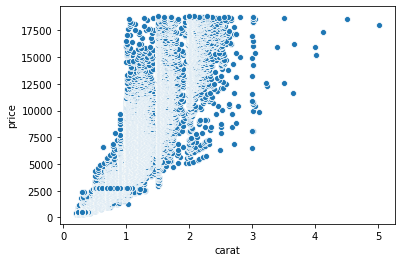

In [12]:
sns.scatterplot(x = "carat", y = "price", data = jems)


Apply a log10 transformation to both the price and carat and store these as new columns in the DataFrame: price_log10 and carat_log10.

In [13]:
jems["price_log10"] = np.log10(jems.price)
jems["carat_log10"] = np.log10(jems.carat)
jems


,carat,cut,color,clarity,depth,table,price,x,y,z,price_log10,carat_log10
0,0.23,Ideal,E,SI2,61.5,55.0,326,3.95,3.98,2.43,2.513218,-0.638272
1,0.21,Premium,E,SI1,59.8,61.0,326,3.89,3.84,2.31,2.513218,-0.677781
2,0.23,Good,E,VS1,56.9,65.0,327,4.05,4.07,2.31,2.514548,-0.638272
3,0.29,Premium,I,VS2,62.4,58.0,334,4.20,4.23,2.63,2.523746,-0.537602
4,0.31,Good,J,SI2,63.3,58.0,335,4.34,4.35,2.75,2.525045,-0.508638
...,...,...,...,...,...,...,...,...,...,...,...,...
53935,0.72,Ideal,D,SI1,60.8,57.0,2757,5.75,5.76,3.50,3.440437,-0.142668
53936,0.72,Good,D,SI1,63.1,55.0,2757,5.69,5.75,3.61,3.440437,-0.142668
53937,0.70,Very Good,D,SI1,62.8,60.0,2757,5.66,5.68,3.56,3.440437,-0.154902
53938,0.86,Premium,H,SI2,61.0,58.0,2757,6.15,6.12,3.74,3.440437,-0.065502


Redraw the scatterplot using the transformed values.

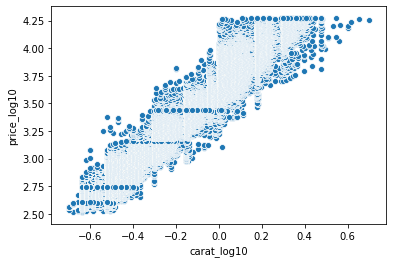

In [14]:
sns.scatterplot(x = "carat_log10", y = "price_log10", data = jems)

Define a linear model that describes the relatioship shown in the plot.
There is a relatioship between the carat and the price as the carat weight increase, the price will increase as well

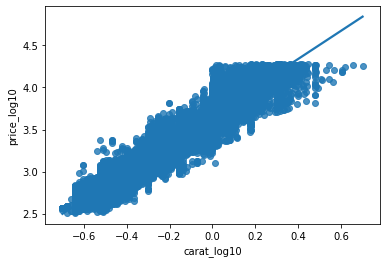

In [15]:
sns.regplot(x = "carat_log10", y = "price_log10", data = jems)